# Análisis Tasa Crímenes Violentos E.E.U.U.

## ABSTRACT
### Guillermo Edwards

### Resumen

El dataset analizado corresponde a información socioeconómica, proveniente del censo estadounidense, e información de índole delictual, proveniente de encuestas y del FBI. Las variables contienen información acerca de ingresos, raza, immigración, entre otras. La variable de estudio (['ViolentCrimesPerPop']) describe el número de crímenes violentos por cada 100.000 habitantes.

Cabe destacar que la data ya ha sido estandarizada, con métodos similares a 'MinMaxScaler' y 'Windsor'. Es decir, todos los valores han sido convertidos a la misma escala de [0; 1], y a los valores atípicos le fueron dados estos valores extremos: 0 para los valores con 3 o más desviaciones estándar bajo la media, y 1 para los valores con 3 o más desviaciones estándar por sobre la media.


### Objetivo

El objetivo del presente análisis es entender qué variables afectan a nuestro objeto de estudio (['ViolentCrimesPerPop']), y, de esta forma, eventualmente realizar un modelo de regresión para poder realizar estimaciones o proyecciones sobre crímenes violentos en el futuro.


### Contexto Comercial

El proyecto es de índole investigativa, con posible aplicación en políticas públicas y/o de seguridad ciudadana.

### Hipótesis

1) Las variables del modelo siguen una distribución normal (hipótesis nula)
2) Las variables independientes del modelo tienen correlación con la variable objetivo (hipótesis no nula).


In [2]:
#importar librerías

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import difflib
import xgboost as xgb
import numpy as np
import ptitprince as pt
from sklearn.ensemble import IsolationForest
import scipy.stats as stats
from scipy.stats import shapiro

from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler, OneHotEncoder
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
import lightgbm as lgb

from sklearn.experimental import enable_halving_search_cv  
from sklearn.model_selection import HalvingGridSearchCV, RandomizedSearchCV
from sklearn.feature_selection import SelectFromModel, mutual_info_regression
from boruta import BorutaPy

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import optuna
from optuna.visualization import plot_optimization_history, plot_param_importances
import shap
from sklearn.decomposition import KernelPCA

In [3]:
# Dataset: variables y definiciones

ruta_names = r"./communities.names"

with open(ruta_names, 'r') as file:
    contenido = file.read()

print(contenido)

Title: Communities and Crime

Abstract: Communities within the United States. The data combines socio-economic data 
from the 1990 US Census, law enforcement data from the 1990 US LEMAS survey, and crime 
data from the 1995 FBI UCR.

-----------------------------------------------------------------------------------------

Data Set Characteristics:  Multivariate
Attribute Characteristics: Real
Associated Tasks: Regression
Number of Instances: 1994
Number of Attributes: 128
Missing Values? Yes
Area: Social
Date Donated: 2009-07-13

-----------------------------------------------------------------------------------------

Source:

Creator: Michael Redmond (redmond 'at' lasalle.edu); Computer Science; La Salle 
University; Philadelphia, PA, 19141, USA
-- culled from 1990 US Census, 1995 US FBI Uniform Crime Report, 1990 US Law 
Enforcement Management and Administrative Statistics Survey, available from ICPSR at U 
of Michigan.
-- Donor: Michael Redmond (redmond 'at' lasalle.edu); Computer

In [4]:
# Diccionario Variables

def Diccionario_Variables(ruta_names):
    Diccionario = {}
    with open(ruta_names, 'r') as file:
        for linea in file:
            if linea.startswith("--"):
                partes = linea[3:].strip().split(":", 1)
                if len(partes) == 2:
                    clave = partes[0].strip()
                    valor = partes[1].strip()
                    Diccionario[clave] = valor
                    
    return Diccionario

Diccionario = Diccionario_Variables(ruta_names)

In [5]:
# Se extraen nombres de columnas

Columnas = []

with open(ruta_names, 'r') as file:
    for linea in file:
        if "@attribute" in linea:
            Columnas.append(linea.split()[1])

print(Columnas)

['state', 'county', 'community', 'communityname', 'fold', 'population', 'householdsize', 'racepctblack', 'racePctWhite', 'racePctAsian', 'racePctHisp', 'agePct12t21', 'agePct12t29', 'agePct16t24', 'agePct65up', 'numbUrban', 'pctUrban', 'medIncome', 'pctWWage', 'pctWFarmSelf', 'pctWInvInc', 'pctWSocSec', 'pctWPubAsst', 'pctWRetire', 'medFamInc', 'perCapInc', 'whitePerCap', 'blackPerCap', 'indianPerCap', 'AsianPerCap', 'OtherPerCap', 'HispPerCap', 'NumUnderPov', 'PctPopUnderPov', 'PctLess9thGrade', 'PctNotHSGrad', 'PctBSorMore', 'PctUnemployed', 'PctEmploy', 'PctEmplManu', 'PctEmplProfServ', 'PctOccupManu', 'PctOccupMgmtProf', 'MalePctDivorce', 'MalePctNevMarr', 'FemalePctDiv', 'TotalPctDiv', 'PersPerFam', 'PctFam2Par', 'PctKids2Par', 'PctYoungKids2Par', 'PctTeen2Par', 'PctWorkMomYoungKids', 'PctWorkMom', 'NumIlleg', 'PctIlleg', 'NumImmig', 'PctImmigRecent', 'PctImmigRec5', 'PctImmigRec8', 'PctImmigRec10', 'PctRecentImmig', 'PctRecImmig5', 'PctRecImmig8', 'PctRecImmig10', 'PctSpeakEnglOn

In [6]:
# Dataset: Se asocia data a columnas correspondientes

ruta_data = r"./communities.data"

df = pd.read_csv(ruta_data, header=None, sep=",", names=Columnas, na_values="?")

pd.set_option('display.max_columns', None)

df.head()

,state,county,community,communityname,fold,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LemasSwornFT,LemasSwFTPerPop,LemasSwFTFieldOps,LemasSwFTFieldPerPop,LemasTotalReq,LemasTotReqPerPop,PolicReqPerOffic,PolicPerPop,RacialMatchCommPol,PctPolicWhite,PctPolicBlack,PctPolicHisp,PctPolicAsian,PctPolicMinor,OfficAssgnDrugUnits,NumKindsDrugsSeiz,PolicAveOTWorked,LandArea,PopDens,PctUsePubTrans,PolicCars,PolicOperBudg,LemasPctPolicOnPatr,LemasGangUnitDeploy,LemasPctOfficDrugUn,PolicBudgPerPop,ViolentCrimesPerPop
0,8,NaN,NaN,Lakewoodcity,1,0.19,0.33,0.02,0.90,0.12,0.17,0.34,0.47,0.29,0.32,0.20,1.00,0.37,0.72,0.34,0.60,0.29,0.15,0.43,0.39,0.40,0.39,0.32,0.27,0.27,0.36,0.41,0.08,0.19,0.10,0.18,0.48,0.27,0.68,0.23,0.41,0.25,0.52,0.68,0.40,0.75,0.75,0.35,0.55,0.59,0.61,0.56,0.74,0.76,0.04,0.14,0.03,0.24,0.27,0.37,0.39,0.07,0.07,0.08,0.08,0.89,0.06,0.14,0.13,0.33,0.39,0.28,0.55,0.09,0.51,0.50,0.21,0.71,0.52,0.05,0.26,0.65,0.14,0.06,0.22,0.19,0.18,0.36,0.35,0.38,0.34,0.38,0.46,0.25,0.04,0.00,0.12,0.42,0.50,0.51,0.64,0.03,0.13,0.96,0.17,0.06,0.18,0.44,0.13,0.94,0.93,0.03,0.07,0.10,0.07,0.02,0.57,0.29,0.12,0.26,0.20,0.06,0.04,0.90,0.50,0.32,0.14,0.20
1,53,NaN,NaN,Tukwilacity,1,0.00,0.16,0.12,0.74,0.45,0.07,0.26,0.59,0.35,0.27,0.02,1.00,0.31,0.72,0.11,0.45,0.25,0.29,0.39,0.29,0.37,0.38,0.33,0.16,0.30,0.22,0.35,0.01,0.24,0.14,0.24,0.30,0.27,0.73,0.57,0.15,0.42,0.36,1.00,0.63,0.91,1.00,0.29,0.43,0.47,0.60,0.39,0.46,0.53,0.00,0.24,0.01,0.52,0.62,0.64,0.63,0.25,0.27,0.25,0.23,0.84,0.10,0.16,0.10,0.17,0.29,0.17,0.26,0.20,0.82,0.00,0.02,0.79,0.24,0.02,0.25,0.65,0.16,0.00,0.21,0.20,0.21,0.42,0.38,0.40,0.37,0.29,0.32,0.18,0.00,0.00,0.21,0.50,0.34,0.60,0.52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.02,0.12,0.45,NaN,NaN,NaN,NaN,0.00,NaN,0.67
2,24,NaN,NaN,Aberdeentown,1,0.00,0.42,0.49,0.56,0.17,0.04,0.39,0.47,0.28,0.32,0.00,0.00,0.30,0.58,0.19,0.39,0.38,0.40,0.84,0.28,0.27,0.29,0.27,0.07,0.29,0.28,0.39,0.01,0.27,0.27,0.43,0.19,0.36,0.58,0.32,0.29,0.49,0.32,0.63,0.41,0.71,0.70,0.45,0.42,0.44,0.43,0.43,0.71,0.67,0.01,0.46,0.00,0.07,0.06,0.15,0.19,0.02,0.02,0.04,0.05,0.88,0.04,0.20,0.20,0.46,0.52,0.43,0.42,0.15,0.51,0.50,0.01,0.86,0.41,0.29,0.30,0.52,0.47,0.45,0.18,0.17,0.16,0.27,0.29,0.27,0.31,0.48,0.39,0.28,0.00,0.00,0.14,0.49,0.54,0.67,0.56,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.01,0.21,0.02,NaN,NaN,NaN,NaN,0.00,NaN,0.43
3,34,5.00,81440.00,Willingborotownship,1,0.04,0.77,1.00,0.08,0.12,0.10,0.51,0.50,0.34,0.21,0.06,1.00,0.58,0.89,0.21,0.43,0.36,0.20,0.82,0.51,0.36,0.40,0.39,0.16,0.25,0.36,0.44,0.01,0.10,0.09,0.25,0.31,0.33,0.71,0.36,0.45,0.37,0.39,0.34,0.45,0.49,0.44,0.75,0.65,0.54,0.83,0.65,0.85,0.86,0.03,0.33,0.02,0.11,0.20,0.30,0.31,0.05,0.08,0.11,0.11,0.81,0.08,0.56,0.62,0.85,0.7

### Se importó la data a analizar. Ésta contiene texto explicativo del contexto de la data y la definición de cada variable. Por esto último, se creó un diccionario para poder acceder a la info facilmente cada vez que sea necesario para entender el contexto de análisis.

### A continuación, se realiza un analisis exploratorio inicial, buscando y tratando valores nulos, duplicados y extremos.

In [7]:
# Valores nulos

nulos = df.isnull().sum()

print(nulos[nulos >0])

df.info()
print(df.shape)

df.describe()

county                  1174
community               1177
OtherPerCap                1
LemasSwornFT            1675
LemasSwFTPerPop         1675
LemasSwFTFieldOps       1675
LemasSwFTFieldPerPop    1675
LemasTotalReq           1675
LemasTotReqPerPop       1675
PolicReqPerOffic        1675
PolicPerPop             1675
RacialMatchCommPol      1675
PctPolicWhite           1675
PctPolicBlack           1675
PctPolicHisp            1675
PctPolicAsian           1675
PctPolicMinor           1675
OfficAssgnDrugUnits     1675
NumKindsDrugsSeiz       1675
PolicAveOTWorked        1675
PolicCars               1675
PolicOperBudg           1675
LemasPctPolicOnPatr     1675
LemasGangUnitDeploy     1675
PolicBudgPerPop         1675
dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1994 entries, 0 to 1993
Columns: 128 entries, state to ViolentCrimesPerPop
dtypes: float64(125), int64(2), object(1)
memory usage: 1.9+ MB
(1994, 128)


,state,county,community,fold,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LemasSwornFT,LemasSwFTPerPop,LemasSwFTFieldOps,LemasSwFTFieldPerPop,LemasTotalReq,LemasTotReqPerPop,PolicReqPerOffic,PolicPerPop,RacialMatchCommPol,PctPolicWhite,PctPolicBlack,PctPolicHisp,PctPolicAsian,PctPolicMinor,OfficAssgnDrugUnits,NumKindsDrugsSeiz,PolicAveOTWorked,LandArea,PopDens,PctUsePubTrans,PolicCars,PolicOperBudg,LemasPctPolicOnPatr,LemasGangUnitDeploy,LemasPctOfficDrugUn,PolicBudgPerPop,ViolentCrimesPerPop
count,1994.00,820.00,817.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1993.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,319.00,1994.00,1994.00,1994.00,319.00,319.00,319.00,319.00,1994.00,319.00,1994.00
mean,28.68,58.83,46188.34,5.49,0.06,0.46,0.18,0.75,0.15,0.14,0.42,0.49,0.34,0.42,0.06,0.70,0.36,0.56,0.29,0.50,0.47,0.32,0.48,0.38,0.35,0.37,0.29,0.20,0.32,0.28,0.39,0.06,0.30,0.32,0.38,0.36,0.36,0.50,0.40,0.44,0.39,0.44,0.46,0.43,0.49,0.49,0.49,0.61,0.62,0.66,0.58,0.50,0.53,0.04,0.25,0.03,0.32,0.36,0.40,0.43,0.18,0.18,0.18,0.18,0.79,0.15,0.27,0.25,0.46,0.49,0.40,0.56,0.19,0.50,0.31,0.08,0.72,0.55,0.20,0.43,0.49,0.26,0.24,0.26,0.26,0.27,0.35,0.37,0.42,0.38,0.49,0.45,0.40,0.03,0.02,0.22,0.61,0.54,0.63,0.65,0.07,0.22,0.92,0.25,0.10,0.22,0.34,0.22,0.69,0.73,0.22,0.13,0.11,0.26,0.08,0.56,0.31,0.07,0.23,0.16,0.16,0.08,0.70,0.44,0.09,0.20,0.24
std,16.40,126.42,25299.73,2.87,0.13,0.16,0.25,0.24,0.21,0.23,0.16,0.14,0.17,0.18,0.13,0.44,0.21,0.18,0.20,0.18,0.17,0.22,0.17,0.20,0.19,0.19,0.17,0.16,0.20,0.19,0.18,0.13,0.23,0.21,0.20,0.21,0.20,0.17,0.20,0.18,0.20,0.19,0.18,0.18,0.18,0.18,0.15,0.20,0.21,0.22,0.19,0.17,0.18,0.11,0.23,0.09,0.22,0.21,0.20,0.19,0.24,0.24,0.24,0.23,0.23,0.22,0.20,0.19,0.17,0.16,0.19,0.20,0.21,0.17,0.26,0.15,0.19,0.19,0.22,0.19,0.23,0.24,0.21,0.22,0.23,0.24,0.22,0.21,0.25,0.21,0.17,0.19,0.19,0.10,0.10,0.23,0.20,0.18,0.20,0.20,0.14,0.16,0.13,0.16,0.16,0.16,0.20,0.16,0.23,0.22,0.24,0.20,0.23,0.23,0.12,0.20,0.23,0.11,0.20,0.23,0.21,0.14,0

In [8]:
Diccionario['racepctblack']

'percentage of population that is african american (numeric - decimal)'

In [9]:
# Se eliminan variables con registros mayoritariamente nulos

eliminar = nulos[(nulos>1) & (nulos.index != 'community')].index
df = df.drop(columns=eliminar)

In [10]:
print(df.isnull().sum())

df.info()
print(df.shape)

df.describe()

state                     0
community              1177
communityname             0
fold                      0
population                0
                       ... 
LandArea                  0
PopDens                   0
PctUsePubTrans            0
LemasPctOfficDrugUn       0
ViolentCrimesPerPop       0
Length: 105, dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1994 entries, 0 to 1993
Columns: 105 entries, state to ViolentCrimesPerPop
dtypes: float64(102), int64(2), object(1)
memory usage: 1.6+ MB
(1994, 105)


,state,community,fold,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LandArea,PopDens,PctUsePubTrans,LemasPctOfficDrugUn,ViolentCrimesPerPop
count,1994.00,817.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1993.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00,1994.00
mean,28.68,46188.34,5.49,0.06,0.46,0.18,0.75,0.15,0.14,0.42,0.49,0.34,0.42,0.06,0.70,0.36,0.56,0.29,0.50,0.47,0.32,0.48,0.38,0.35,0.37,0.29,0.20,0.32,0.28,0.39,0.06,0.30,0.32,0.38,0.36,0.36,0.50,0.40,0.44,0.39,0.44,0.46,0.43,0.49,0.49,0.49,0.61,0.62,0.66,0.58,0.50,0.53,0.04,0.25,0.03,0.32,0.36,0.40,0.43,0.18,0.18,0.18,0.18,0.79,0.15,0.27,0.25,0.46,0.49,0.40,0.56,0.19,0.50,0.31,0.08,0.72,0.55,0.20,0.43,0.49,0.26,0.24,0.26,0.26,0.27,0.35,0.37,0.42,0.38,0.49,0.45,0.40,0.03,0.02,0.22,0.61,0.54,0.63,0.65,0.07,0.23,0.16,0.09,0.24
std,16.40,25299.73,2.87,0.13,0.16,0.25,0.24,0.21,0.23,0.16,0.14,0.17,0.18,0.13,0.44,0.21,0.18,0.20,0.18,0.17,0.22,0.17,0.20,0.19,0.19,0.17,0.16,0.20,0.19,0.18,0.13,0.23,0.21,0.20,0.21,0.20,0.17,0.20,0.18,0.20,0.19,0.18,0.18,0.18,0.18,0.15,0.20,0.21,0.22,0.19,0.17,0.18,0.11,0.23,0.09,0.22,0.21,0.20,0.19,0.24,0.24,0.24,0.23,0.23,0.22,0.20,0.19,0.17,0.16,0.19,0.20,0.21,0.17,0.26,0.15,0.19,0.19,0.22,0.19,0.23,0.24,0.21,0.22,0.23,0.24,0.22,0.21,0.25,0.21,0.17,0.19,0.19,0.10,0.10,0.23,0.20,0.18,0.20,0.20,0.11,0.20,0.23,0.24,0.23
min,1.00,70.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,12.00,25065.00,3.00,0.01,0.35,0.02,0.63,0.04,0.01,0.34,0.41,0.25,0.30,0.00,0.00,0.20,0.44,0.16,0.37,0.35,0.14,0.36,0.23,0.22,0.24,0.17,0.11,0.19,0.17,0.26,0.01,0.11,0.16,0.23,0.21,0.22,0.38,0.25,0.32,

In [11]:
# Columna ID: se crea variable de valor único para cada registro, concatentando 'state' y 'communityname'.

df['state_comm'] = df['state'].astype(str)+"_"+df['communityname'].astype(str)

print(df[['state_comm', 'state', 'communityname']].head())

               state_comm  state        communityname
0          8_Lakewoodcity      8         Lakewoodcity
1          53_Tukwilacity     53          Tukwilacity
2         24_Aberdeentown     24         Aberdeentown
3  34_Willingborotownship     34  Willingborotownship
4    42_Bethlehemtownship     42    Bethlehemtownship


In [12]:
# Se busca llenar nulos en columna 'communinty'

def relleno_comm(df):
    for idx, row in df[df['community'].isnull()].iterrows():
        filtro = (df['state_comm'] == row['state_comm']) & df['community'].notnull()
        
        if filtro.any():
            reemplazo = df.loc[filtro, 'community'].iloc[0]
            df.at[idx, 'community'] = reemplazo
        
    return df

df = relleno_comm(df)

print(df['community'].isnull().sum())

1177


se intentó encontrar los valores para los registros nulos de community, sin resultado.

In [13]:
# Se eliminan columnas

df = df.drop(columns='community')

In [14]:
df = df.drop(columns='fold')

In [15]:
# Se revisan duplicados para columna ID

df[df['state_comm'].duplicated(keep=False)]

,state,communityname,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LandArea,PopDens,PctUsePubTrans,LemasPctOfficDrugUn,ViolentCrimesPerPop,state_comm


In [16]:
df['state_comm'].unique().size

1994

In [17]:
print(pd.Series(df['state_comm'].unique()).sort_values())

1514           10_Dovercity
1044      11_Washingtoncity
148           12_Bartowcity
638        12_BocaRatoncity
110     12_BoyntonBeachcity
               ...         
1786     9_Wethersfieldtown
1297           9_Wiltontown
1368     9_WindsorLockstown
1550          9_Windsortown
98            9_Wolcotttown
Length: 1994, dtype: object


In [18]:
# Se revisan posibles duplicados con nombre similar

Comm = df['state_comm'].dropna().unique()

def encontrar_similares(lista, palabra, n=5, umbral=0.8):
    similares = difflib.get_close_matches(palabra, lista, n=n, cutoff=umbral)
    return similares

Cont = 0

for i in df['state_comm'].dropna().unique():
    Sim = []
    similares = encontrar_similares(df.loc[df['state_comm'] == i, 'communityname'], df.loc[df['state_comm'] == i, 'communityname'].iloc[0], umbral=0.8)
    if len(Sim) > 1:
        Cont = Cont + len(len) - 1
        Sim.append(similares)
        print(f'Similares en {i}: ', Sim)
print("Total similares es ", Cont) 

Total similares es  0


In [19]:
Diccionario['OtherPerCap']

"per capita income for people with 'other' heritage (numeric - decimal)"

### A continuación, se realizan análisis estadísticos para entender la distribución de las variables, y las relaciones entre éstas.

In [20]:
# Test de normalidad
cont = 0

for col in df.select_dtypes(include='number').columns:
    stat, p_valor = shapiro(df[col])
    print("Para: ", col, "Stat: ", stat, "\n pvalor: ", p_valor, "\n")
    if p_valor > 0.05:
        print(col, ": Distribución normal \n")
        cont = cont +1
    else: print(col, " Distribución no es normal \n")

print('varibles con distribución normal = ', cont)

Para:  state Stat:  0.9225937115086438 
 pvalor:  7.516200049988358e-31 

state  Distribución no es normal 

Para:  population Stat:  0.4255921009692464 
 pvalor:  4.3586307798819885e-62 

population  Distribución no es normal 

Para:  householdsize Stat:  0.940209251042442 
 pvalor:  1.2146664105015835e-27 

householdsize  Distribución no es normal 

Para:  racepctblack Stat:  0.7040388421099877 
 pvalor:  1.6492846344546747e-50 

racepctblack  Distribución no es normal 

Para:  racePctWhite Stat:  0.8423167194536267 
 pvalor:  1.1813806020482036e-40 

racePctWhite  Distribución no es normal 

Para:  racePctAsian Stat:  0.6432491047240327 
 pvalor:  1.202515876327021e-53 

racePctAsian  Distribución no es normal 

Para:  racePctHisp Stat:  0.6192679314008931 
 pvalor:  9.217386511123974e-55 

racePctHisp  Distribución no es normal 

Para:  agePct12t21 Stat:  0.8708624039873448 
 pvalor:  9.263560603279489e-38 

agePct12t21  Distribución no es normal 

Para:  agePct12t29 Stat:  0.89565

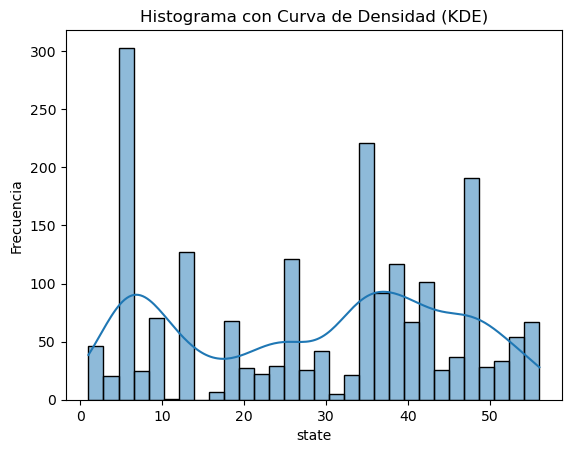

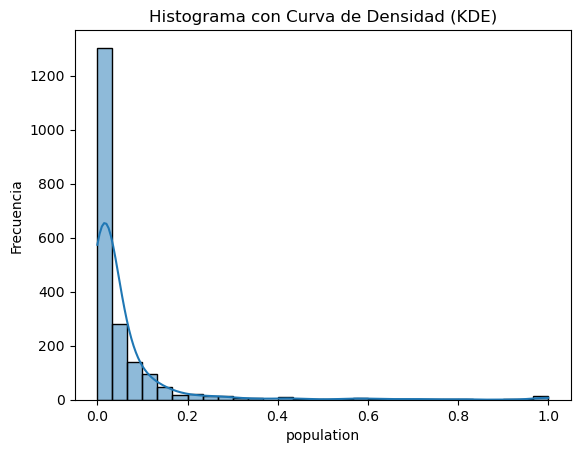

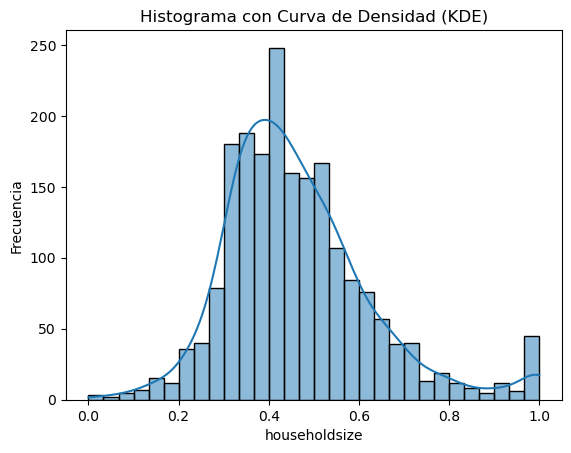

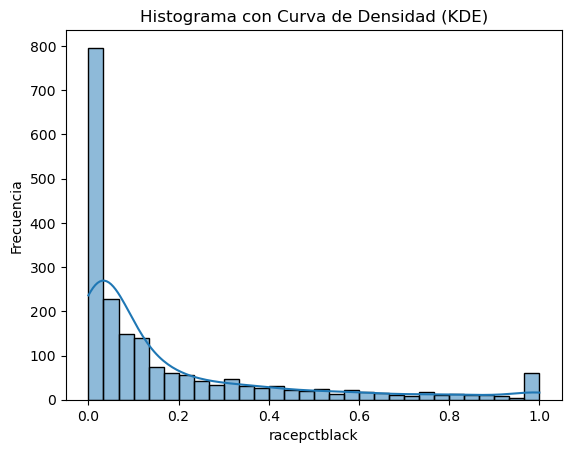

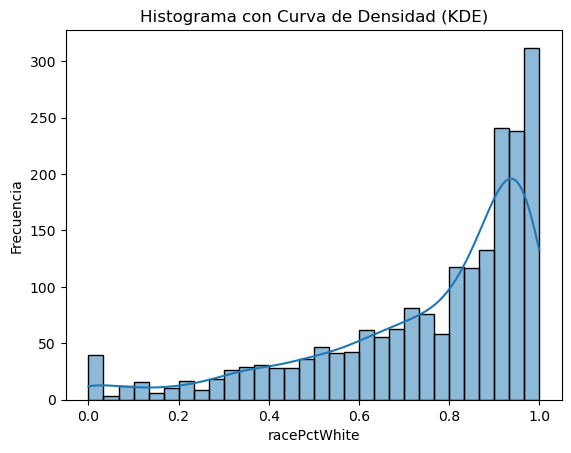

...

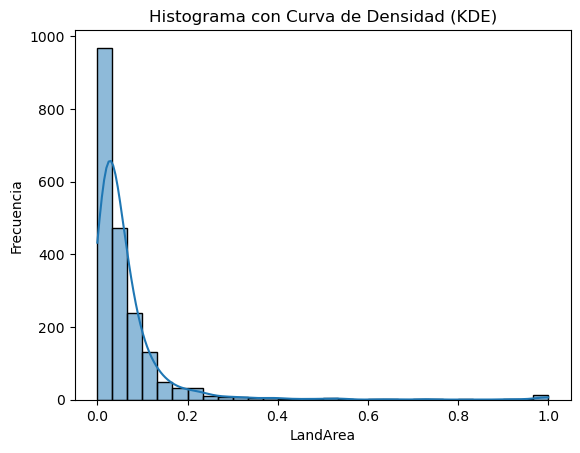

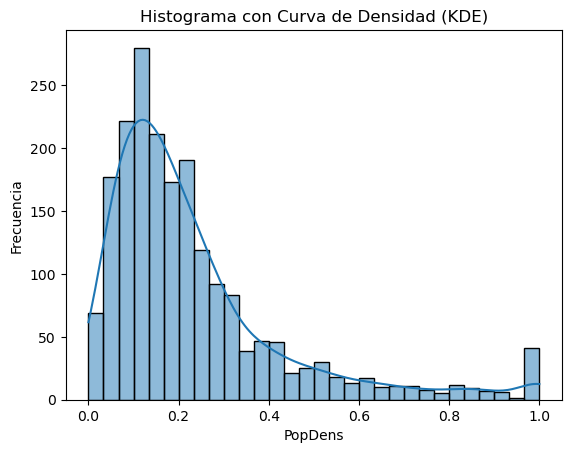

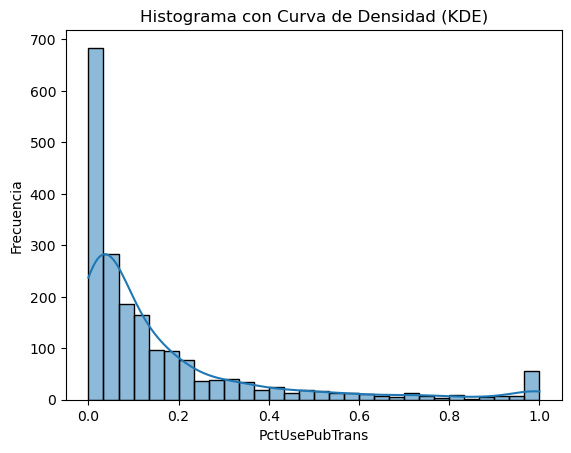

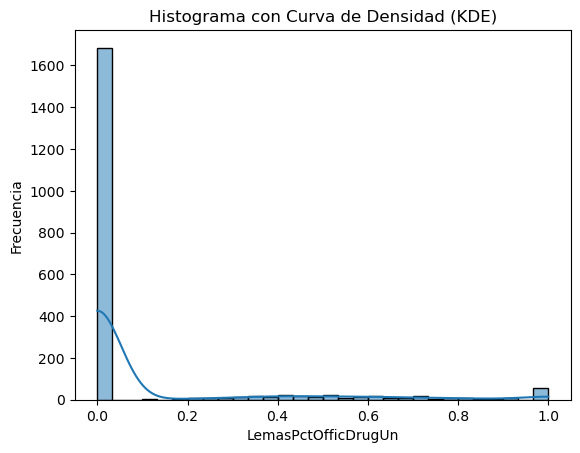

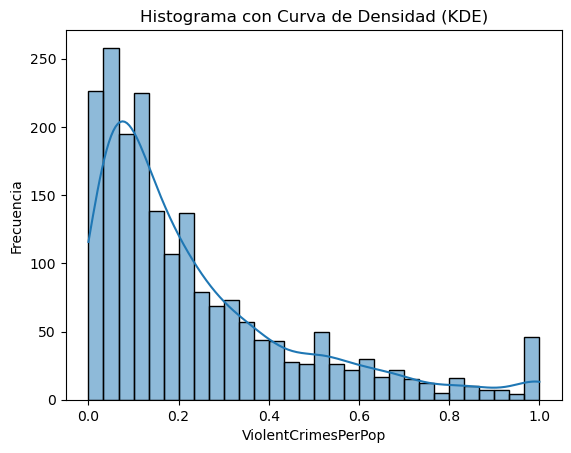

In [21]:
# Verificamos distribución graficamente

for col in df.select_dtypes(include='number').columns:
    sns.histplot(df[col], kde=True, bins=30)
    plt.title("Histograma con Curva de Densidad (KDE)")
    plt.xlabel(col)
    plt.ylabel("Frecuencia")
    plt.show()

In [22]:
# Test de correlación variable objetivo ('ViolentCrimesPerPop')

correlacion = {}

for col in df.select_dtypes(include='number').columns:
    stat, p_valor = stats.spearmanr(df['ViolentCrimesPerPop'], df[col])
    
    if p_valor > 0.05:
        correlacion[col] = 0
        print(col, ": no hay correlación \n")
    else: 
        correlacion[col] = 1
        print(col, ": hay correlación")
        
print(correlacion)

state : hay correlación
population : hay correlación
householdsize : hay correlación
racepctblack : hay correlación
racePctWhite : hay correlación
racePctAsian : no hay correlación 

racePctHisp : hay correlación
agePct12t21 : hay correlación
agePct12t29 : hay correlación
agePct16t24 : hay correlación
agePct65up : hay correlación
numbUrban : hay correlación
pctUrban : hay correlación
medIncome : hay correlación
pctWWage : hay correlación
pctWFarmSelf : hay correlación
pctWInvInc : hay correlación
pctWSocSec : hay correlación
pctWPubAsst : hay correlación
pctWRetire : hay correlación
medFamInc : hay correlación
perCapInc : hay correlación
whitePerCap : hay correlación
blackPerCap : hay correlación
indianPerCap : no hay correlación 

AsianPerCap : hay correlación
OtherPerCap : hay correlación
HispPerCap : hay correlación
NumUnderPov : hay correlación
PctPopUnderPov : hay correlación
PctLess9thGrade : hay correlación
PctNotHSGrad : hay correlación
PctBSorMore : hay correlación
PctUnemploy

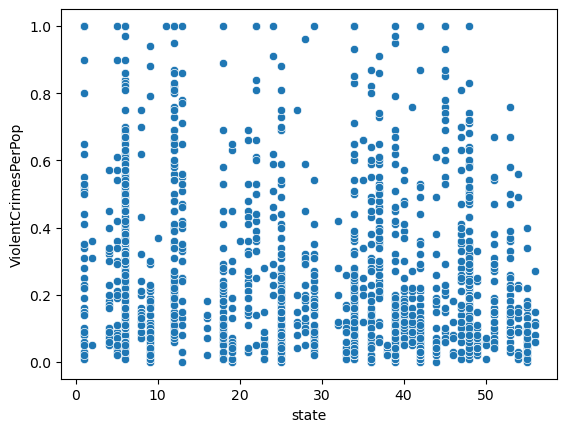

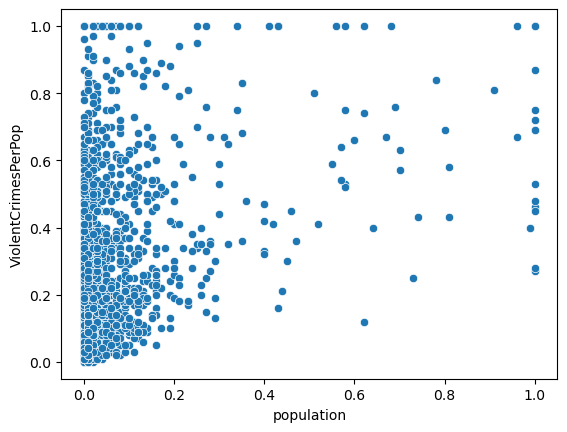

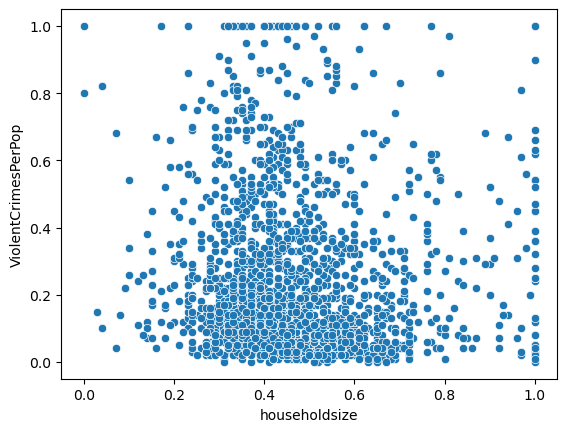

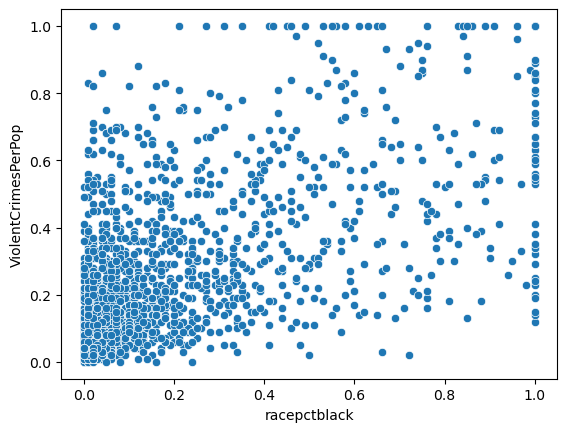

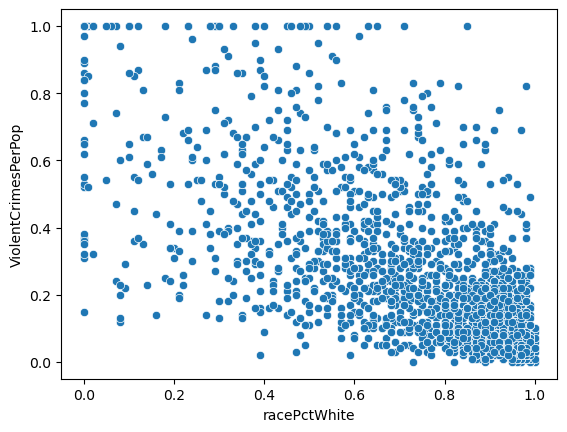

...

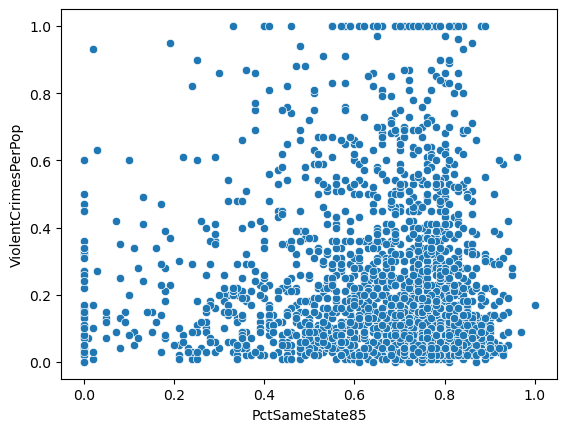

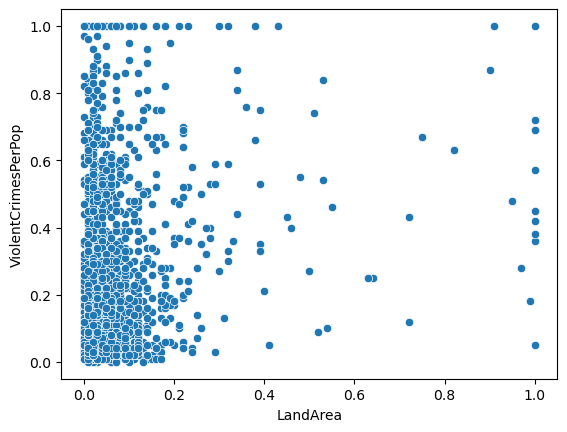

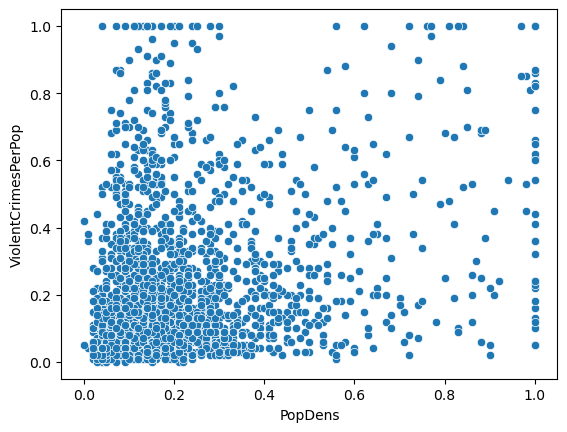

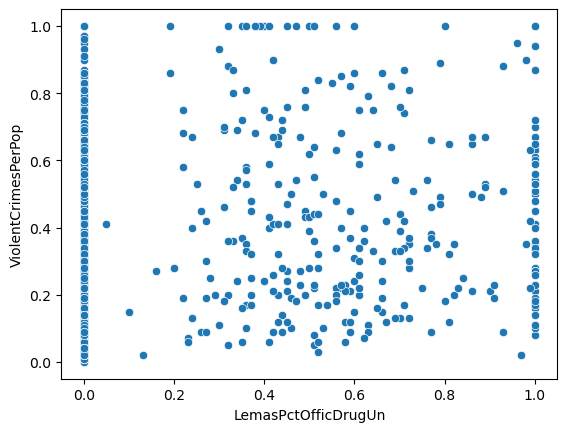

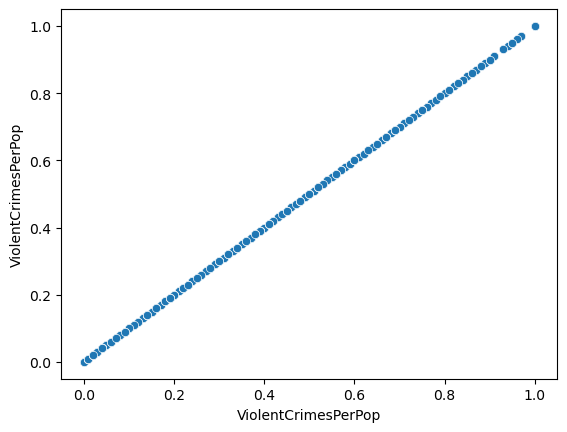

In [23]:
# verificamos correlación gráficamente

for col in df.select_dtypes(include='number').columns:
    if correlacion[col] == 1:
        sns.scatterplot(data=df, x=col, y='ViolentCrimesPerPop')
        plt.show()

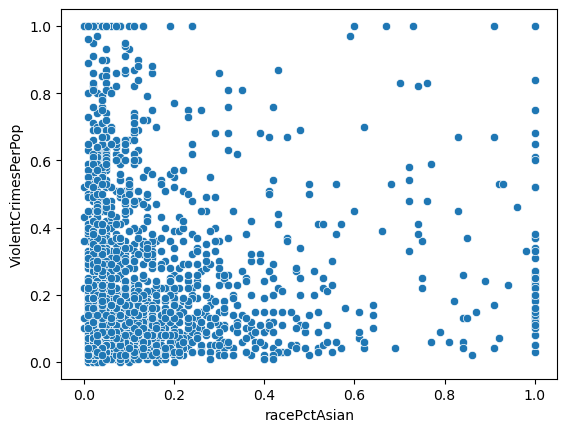

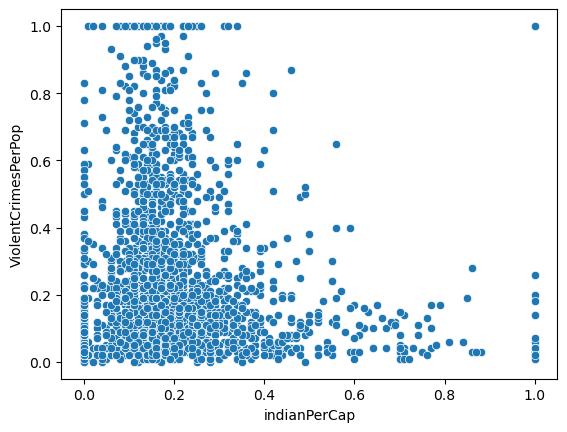

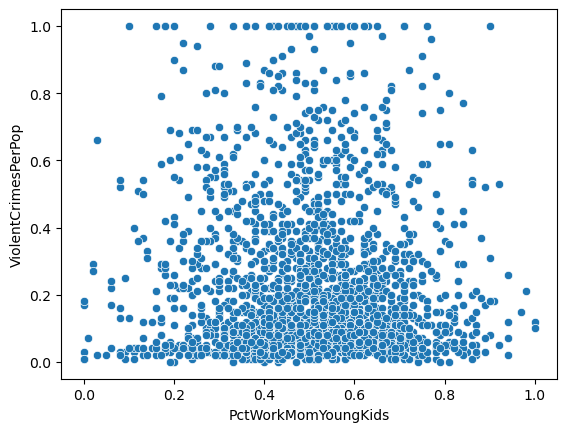

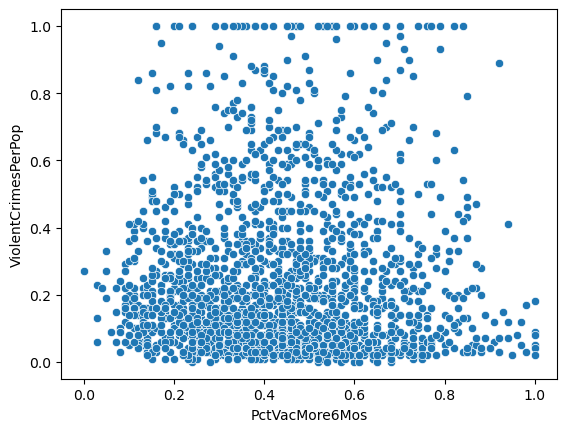

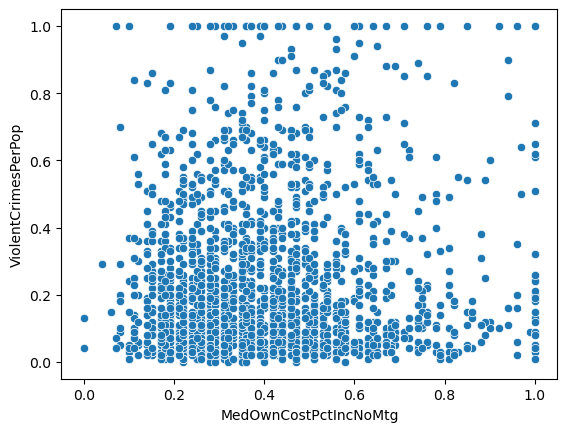

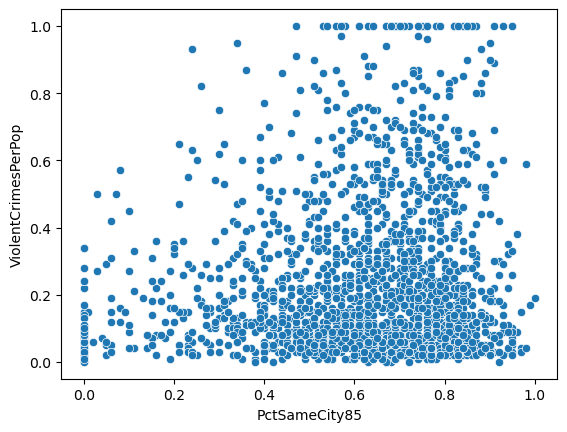

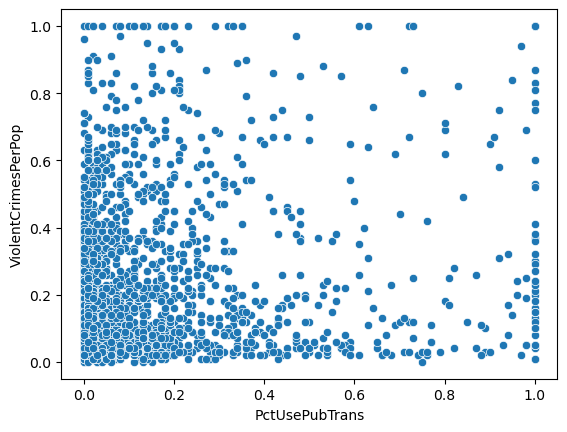

In [24]:
# verificamos correlación gr+aficamente

for col in df.select_dtypes(include='number').columns:
    if correlacion[col] == 0:
        sns.scatterplot(data=df, x=col, y='ViolentCrimesPerPop')
        plt.show()

no se puede confirmar la no correlación gráficamente, por lo que por ahora no se eliminan variables

In [25]:
print(pd.Series(correlacion).sort_values())

PctUsePubTrans         0
PctWorkMomYoungKids    0
indianPerCap           0
racePctAsian           0
PctSameCity85          0
                      ..
PctLess9thGrade        1
PctPopUnderPov         1
NumUnderPov            1
OtherPerCap            1
ViolentCrimesPerPop    1
Length: 102, dtype: int64


In [26]:
df[df['OtherPerCap'].isnull()]

,state,communityname,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LandArea,PopDens,PctUsePubTrans,LemasPctOfficDrugUn,ViolentCrimesPerPop,state_comm
130,28,Natchezcity,0.02,0.38,0.98,0.22,0.01,0.01,0.44,0.40,0.27,0.58,0.00,0.00,0.09,0.24,0.35,0.31,0.65,0.78,0.49,0.12,0.18,0.32,0.15,0.08,0.37,NaN,0.63,0.05,0.85,0.54,0.54,0.29,0.86,0.19,0.31,0.53,0.37,0.51,0.62,0.44,0.62,0.65,0.49,0.20,0.20,0.13,0.19,0.59,0.50,0.04,0.85,0.00,0.22,0.16,0.13,0.11,0.01,0.00,0.00,0.00,0.98,0.02,0.28,0.24,0.40,0.36,0.47,0.52,0.17,0.46,0.50,0.05,0.52,0.55,0.31,0.68,0.38,0.51,0.55,0.06,0.06,0.08,0.00,0.06,0.11,0.11,0.60,0.44,0.76,0.00,0.00,0.01,0.84,0.70,0.83,0.77,0.04,0.12,0.05,0.00,0.23,28_Natchezcity


In [27]:
# Se elimina valor nulo

df = df.dropna(subset=['OtherPerCap'])

In [28]:
nulos = df.isnull().sum()
print(nulos[nulos>0])

Series([], dtype: int64)


In [29]:
print(df.info())
df.shape

<class 'pandas.core.frame.DataFrame'>
Index: 1993 entries, 0 to 1993
Columns: 104 entries, state to state_comm
dtypes: float64(101), int64(1), object(2)
memory usage: 1.6+ MB
None


(1993, 104)

### Como se comentó al comienzo, la data ya ha sido escalada y los valores atípicos tratados. Sin embargo buscaremos éstos valores para entender el comportamiento de nuestros datos.

In [30]:
# Se buscan posibles outliers: análisis univariado estándar

outliers_uni = pd.DataFrame()
out_count = {}

for col in df.select_dtypes(include='number').columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3-Q1
    lim_inf = Q1-1.5*IQR
    lim_sup = Q3+1.5*IQR
    
    out_col = df[(df[col]<lim_inf) | (df[col]>lim_sup)]
    out_count[col] = out_col.shape[0]
    outliers_uni = pd.concat([outliers_uni, out_col])
    
outliers_uni = outliers_uni.drop_duplicates()

print("total registros con outliers: ", len(outliers_uni), "\n\n", outliers_uni, "\n")
print("outliers por variable \n", out_count)

total registros con outliers:  1540 

       state     communityname  population  householdsize  racepctblack  \
0         8      Lakewoodcity        0.19           0.33          0.02   
10        6      DalyCitycity        0.13           0.71          0.15   
16       36        Albanycity        0.15           0.31          0.40   
20        6       Modestocity        0.25           0.54          0.05   
21       12  Jacksonvillecity        1.00           0.42          0.47   
...     ...               ...         ...            ...           ...   
1749     12         Ocalacity        0.05           0.32          0.46   
1880     34        Lindencity        0.04           0.39          0.39   
1981      9        Hamdentown        0.07           0.38          0.17   
615      36    GlensFallscity        0.01           0.33          0.02   
1831     12        DeLandcity        0.01           0.34          0.43   

      racePctWhite  racePctAsian  racePctHisp  agePct12t21  agePct12t29 

In [31]:
out = pd.DataFrame(list(out_count.items()), columns=(['Variable', 'Outliers'])).sort_values(by='Outliers', ascending=False)
out[out['Outliers']>200]

,Variable,Outliers
91,NumStreet,397
90,NumInShelters,396
100,LemasPctOfficDrugUn,309
50,NumIlleg,247
52,NumImmig,245
62,PctNotSpeakEnglWell,231
6,racePctHisp,230
1,population,218
3,racepctblack,216
5,racePctAsian,216


In [32]:
# Se buscan posibles outliers: valores extremos Windsor (0 y 1)

outliers_uni = pd.DataFrame()
out_count = {}

for col in df.select_dtypes(include='number').columns:
        
    out_col = df[(df[col]==0) | (df[col]==1)]
    out_count[col] = out_col.shape[0]
    outliers_uni = pd.concat([outliers_uni, out_col])
    
outliers_uni = outliers_uni.drop_duplicates()

print("total registros con outliers: ", len(outliers_uni), "\n\n", outliers_uni, "\n")
print("outliers por variable \n", out_count)

total registros con outliers:  1992 

       state    communityname  population  householdsize  racepctblack  \
30        1      Cullmancity        0.01           0.30          0.00   
32        1       Auburncity        0.04           0.37          0.32   
42        1    Fairfieldcity        0.00           0.45          1.00   
58        1   Huntsvillecity        0.24           0.37          0.48   
225       1    Sheffieldcity        0.00           0.31          0.46   
...     ...              ...         ...            ...           ...   
1747      6    Lancastercity        0.14           0.60          0.14   
1981      9       Hamdentown        0.07           0.38          0.17   
1327     32    Hendersoncity        0.09           0.51          0.05   
1465      2    Anchoragecity        0.35           0.48          0.13   
1782      9  Wallingfordtown        0.05           0.46          0.02   

      racePctWhite  racePctAsian  racePctHisp  agePct12t21  agePct12t29  \
30       

In [33]:
Diccionario['NumUnderPov']

'number of people under the poverty level (numeric - decimal)'

In [34]:
# Se da una primera mirada a correlaciones entre variables independientes

Corr = df.select_dtypes(include='number').corr(method='spearman')
umbral = 0.8

matriz_pares = Corr.unstack().reset_index()
matriz_pares.columns = ['Var1', 'Var2', 'Corr']
matriz_pares = matriz_pares[(matriz_pares['Corr']>=umbral) & (matriz_pares['Var1'] != matriz_pares['Var2'])]

pd.set_option('display.max_rows', 500)
matriz_pares = matriz_pares.sort_values(by='Corr', ascending=False)
matriz_pares

,Var1,Var2,Corr
8241,OwnOccLowQuart,OwnOccMedVal,0.99
8342,OwnOccMedVal,OwnOccLowQuart,0.99
8445,OwnOccHiQuart,OwnOccMedVal,0.99
8344,OwnOccMedVal,OwnOccHiQuart,0.99
8654,RentMedian,MedRent,0.99
8856,MedRent,RentMedian,0.99
8653,RentMedian,RentHighQ,0.99
8754,RentHighQ,RentMedian,0.99
6179,PctRecImmig10,PctRecImmig8,0.99
6078,PctRecImmig8,PctRecImmig10,0.99


In [35]:
pd.set_option('display.max_rows', 100)
matriz_pares[matriz_pares['Corr']>=0.99].sort_values(by='Corr', ascending=False)

,Var1,Var2,Corr
8241,OwnOccLowQuart,OwnOccMedVal,0.99
8342,OwnOccMedVal,OwnOccLowQuart,0.99
8445,OwnOccHiQuart,OwnOccMedVal,0.99
8344,OwnOccMedVal,OwnOccHiQuart,0.99


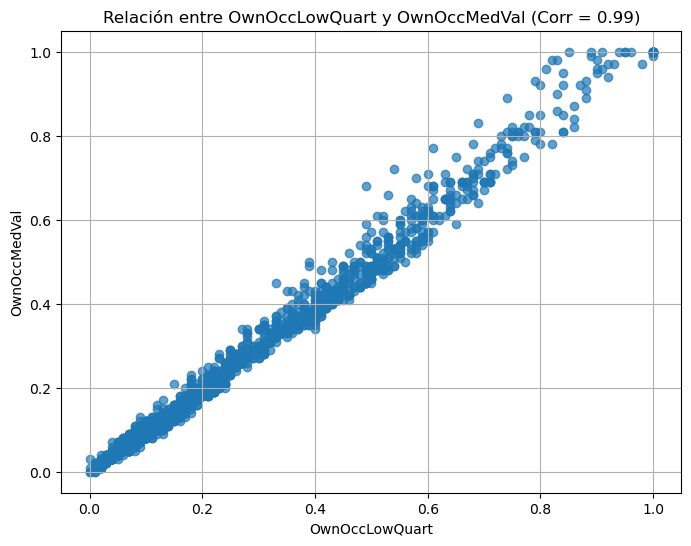

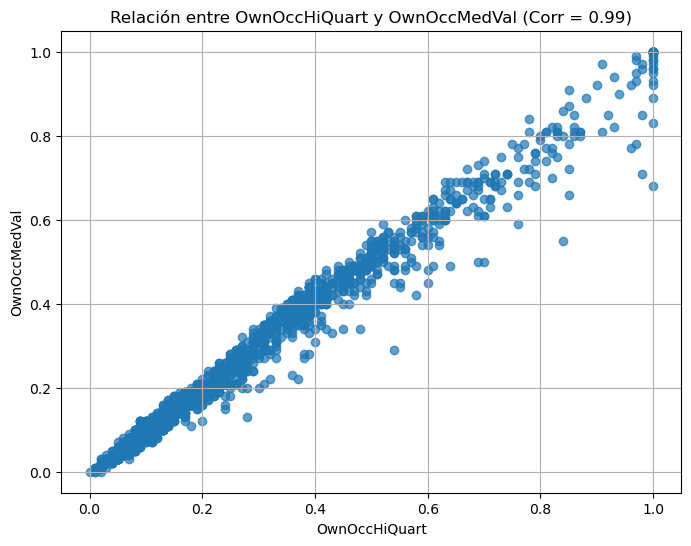

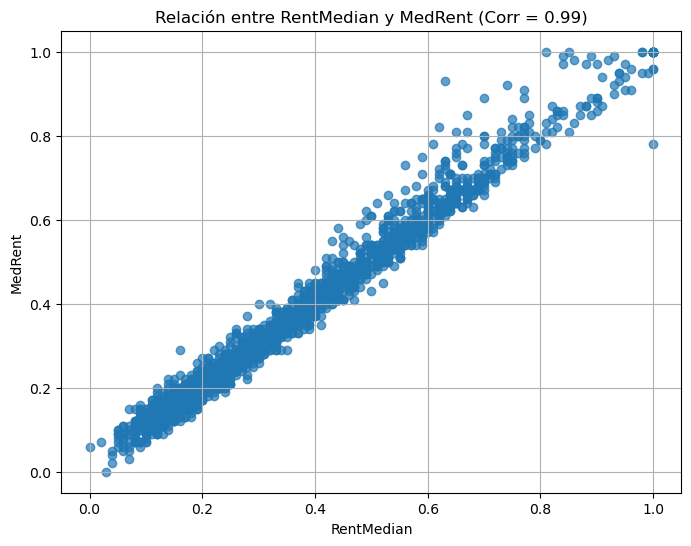

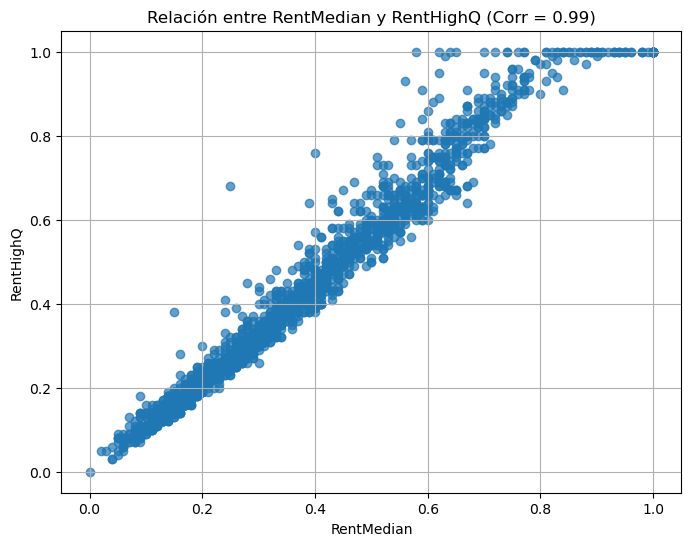

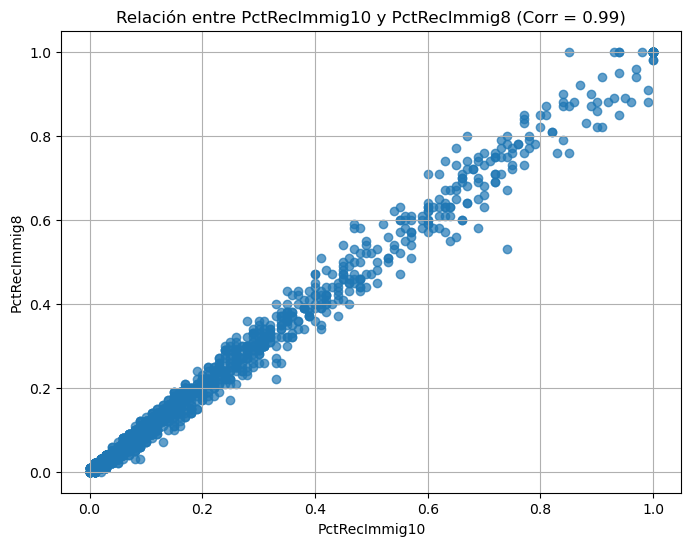

...

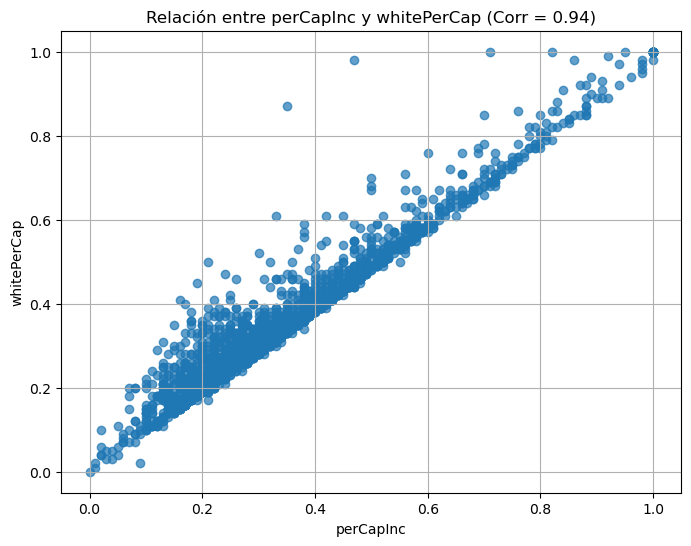

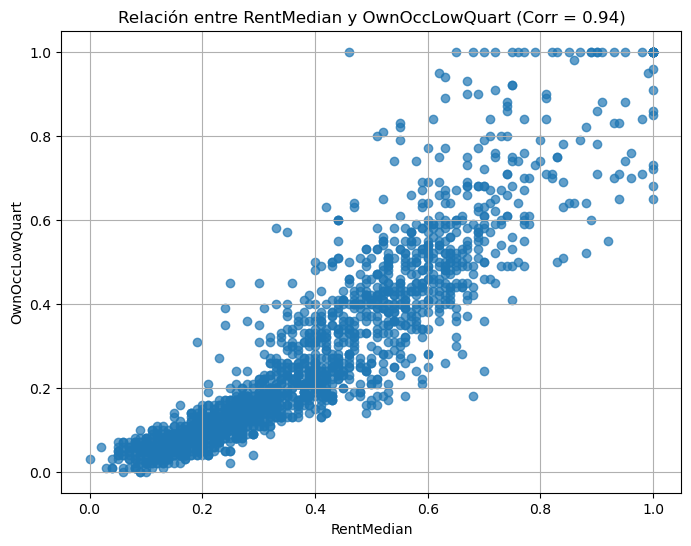

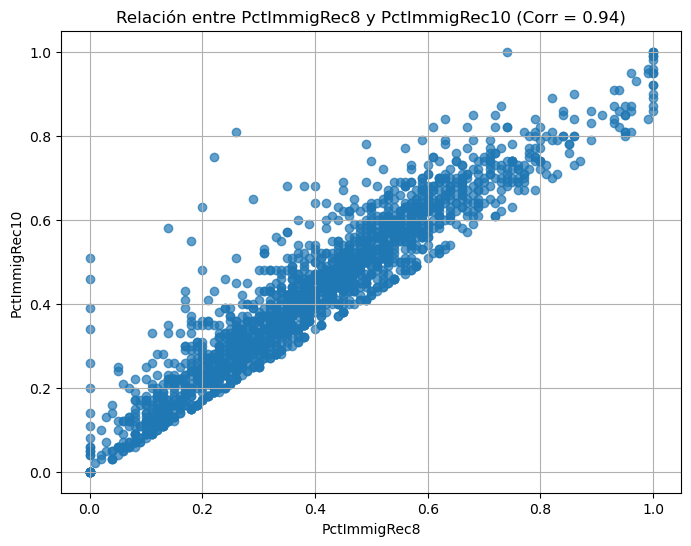

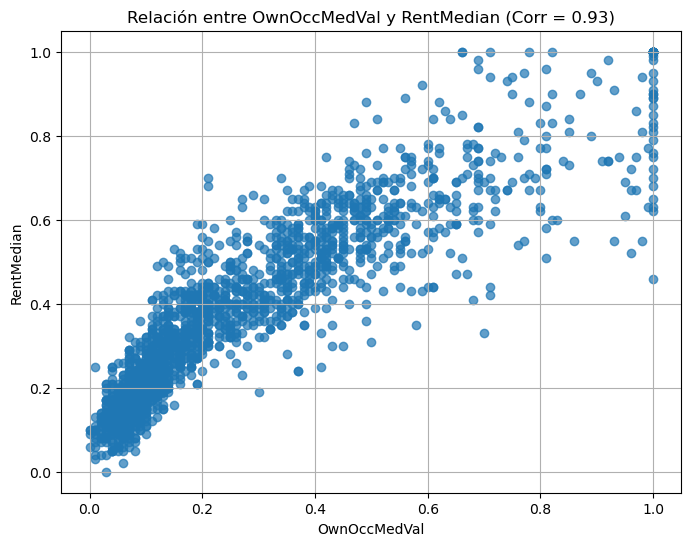

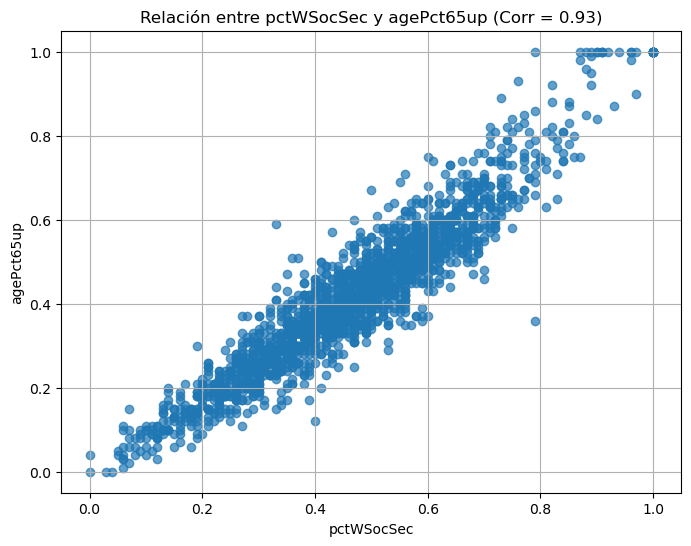

In [36]:
# Chequeamos linealidad en correlación de pares

top_pares = matriz_pares.iloc[::2].head(30)

for idx, row in top_pares.iterrows():
    var1 = row['Var1']
    var2 = row['Var2']
    
    # Crear un gráfico de dispersión para cada par
    plt.figure(figsize=(8, 6))
    plt.scatter(df[var1], df[var2], alpha=0.7)
    plt.title(f"Relación entre {var1} y {var2} (Corr = {row['Corr']:.2f})")
    plt.xlabel(var1)
    plt.ylabel(var2)
    plt.grid(True)
    plt.show()

In [37]:
# correlación con variable objetivo

objetivo = 'ViolentCrimesPerPop'
Corr_obj = df.select_dtypes(include='number').corr(method='spearman')[objetivo].sort_values(ascending=False)

pd.set_option('display.max_rows', 200)
print(Corr_obj)

ViolentCrimesPerPop      1.00
PctIlleg                 0.74
NumIlleg                 0.71
NumUnderPov              0.66
PctPersDenseHous         0.65
FemalePctDiv             0.64
TotalPctDiv              0.63
pctWPubAsst              0.63
PctPopUnderPov           0.62
racepctblack             0.60
MalePctDivorce           0.59
PctHousNoPhone           0.59
PctUnemployed            0.55
PctHousLess3BR           0.54
PctNotHSGrad             0.53
HousVacant               0.52
PctLess9thGrade          0.48
NumStreet                0.44
PctVacantBoarded         0.44
PctLargHouseFam          0.44
NumInShelters            0.43
population               0.37
PctWOFullPlumb           0.37
MedRentPctHousInc        0.36
LemasPctOfficDrugUn      0.36
PctImmigRec10            0.35
PctOccupManu             0.34
racePctHisp              0.32
MalePctNevMarr           0.32
agePct16t24              0.32
PctImmigRec8             0.32
PersPerRentOccHous       0.31
PctLargHouseOccup        0.31
agePct12t2

In [38]:
#Variables dependiente e independientes

x = df.drop(columns= ['communityname', 'state_comm', 'ViolentCrimesPerPop'])
y = df['ViolentCrimesPerPop']

In [39]:
# Visualización unitaria

variables = [col for col in (list(x.drop(columns='state').columns)+list(y.to_frame().columns))]

filas = len(variables)

fig, axes = plt.subplots(filas, 1, figsize= (20, 5*filas), constrained_layout=True)

if filas ==1:
    axes = [axes]

for ax, variable in zip(axes, variables):
    pt.RainCloud(x=None, y=variable, data=df[(list(x.drop(columns='state').columns)+list(y.to_frame().columns))], ax=ax, orient='h', width_viol=0.6)
    ax.set_title(variable, fontsize=15)
    
plt.tight_layout()
plt.show()

In [40]:
Diccionario['racepctblack']

'percentage of population that is african american (numeric - decimal)'

In [41]:
# Se buscan posibles outliers: análisis multivariado

iso_forest = IsolationForest(contamination=0.05, random_state=65)

df['outlier'] = iso_forest.fit_predict(df.select_dtypes(include='number'))

outliers = df[df['outlier']==-1]

print("N° outliers: ", len(outliers), "\n\n")
print(outliers)

N° outliers:  100 


      state              communityname  population  householdsize  \
10        6               DalyCitycity        0.13           0.71   
24        6                 Delanocity        0.02           0.96   
39       34         Plainsborotownship        0.01           0.14   
115      34        WestWindsortownship        0.01           0.61   
116       6              Inglewoodcity        0.16           0.64   
119       6            SantaMonicacity        0.12           0.07   
155      34                Passaiccity        0.08           0.67   
173      48               Edinburgcity        0.03           0.90   
177      34             JerseyCitycity        0.35           0.50   
243       6                ElMontecity        0.15           1.00   
296       6              LongBeachcity        0.67           0.46   
305       6           BeverlyHillscity        0.04           0.20   
325       4                Nogalescity        0.02           0.98   
336      49  

### Se evaluaron distintas opciones para tratamiento de outliers (considerando tanto outliers calculados con el estado actual de la data como los valores extremos [0, 1], reemplazando por medianas y medias, tomando en cuenta el total así como agrupando por estado ['state']), pero fueron descartadas.

In [42]:
df = df.drop(columns=['outlier'])

In [43]:
x = df.drop(columns= ['communityname', 'state_comm', 'ViolentCrimesPerPop'])
y = df['ViolentCrimesPerPop']

### Conclusiónes preliminares

- Las variables estudiadas no siguen una distribución normal, por lo que se rechaza la primera hipótesis nula.
- Gran parte de las variables independientes tienen correlación con la variable objetivo, por lo que se acepta la segunda hipótesis no nula. Estas relaciones son no lineales en su mayoría.
- Existe una fuerte correlación entre variables dependientes, por lo que reducir la dimensionalidad sería el próximo paso a seguir.
- Se aislaron posibles outliers, pero éstos han sido tratados anteriormente, lo cual habrá que tener en cuenta a la hora de diseñar nuestro modelo de regresión.

In [44]:
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(x, y)

# Seleccionar características importantes
selector = SelectFromModel(rf, prefit=True, threshold="mean")
seleccion_rf = selector.transform(x)

# Mostrar las variables seleccionadas
selected_features = x.columns[selector.get_support()]
print("Variables seleccionadas:", selected_features)

# DataFrame con las características reducidas
z = pd.DataFrame(seleccion_rf, columns=selected_features, index=x.index)
z.head()

Variables seleccionadas: Index(['state', 'racePctWhite', 'PctFam2Par', 'PctKids2Par', 'NumIlleg',
       'PctIlleg', 'NumStreet'],
      dtype='object')


,state,racePctWhite,PctFam2Par,PctKids2Par,NumIlleg,PctIlleg,NumStreet
0,8.00,0.90,0.55,0.59,0.04,0.14,0.00
1,53.00,0.74,0.43,0.47,0.00,0.24,0.00
2,24.00,0.56,0.42,0.44,0.01,0.46,0.00
3,34.00,0.08,0.65,0.54,0.03,0.33,0.00
4,42.00,0.95,0.91,0.91,0.00,0.06,0.00


In [45]:
z.shape

(1993, 7)

### Luego de probar distintos métodos de reducción de características (LGB, SHAP, MutualInformation, PCA, KPCA, entre otros), se obtuvo el mejor resultado utilizando RandomForest para la selección de características.

### Luego de realizar selección de características, realizamos transformación y escalamiento de los datos para poder entrenar modelos de manera óptima.

In [46]:
# transformación de datos

if 'state' in z.columns:
    
    categorical_cols = ['state']
    num_cols = [col for col in z.drop(columns='state').columns]

    categorical_transformer = OneHotEncoder(handle_unknown='ignore')

    preprocessor = ColumnTransformer(
        transformers=[
            ('cat', categorical_transformer, categorical_cols),
            ('num', 'passthrough', num_cols)
                    ]
                                    )
    
    z = preprocessor.fit_transform(z)
    
    cat_cols = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_cols)
    columnas = list(cat_cols) + num_cols
    columnas

    z = z.toarray()
    z = pd.DataFrame(z, columns=columnas)
    
    print(z.head())

   state_1.0  state_2.0  state_4.0  state_5.0  state_6.0  state_8.0  \
0       0.00       0.00       0.00       0.00       0.00       1.00   
1       0.00       0.00       0.00       0.00       0.00       0.00   
2       0.00       0.00       0.00       0.00       0.00       0.00   
3       0.00       0.00       0.00       0.00       0.00       0.00   
4       0.00       0.00       0.00       0.00       0.00       0.00   

   state_9.0  state_10.0  state_11.0  state_12.0  state_13.0  state_16.0  \
0       0.00        0.00        0.00        0.00        0.00        0.00   
1       0.00        0.00        0.00        0.00        0.00        0.00   
2       0.00        0.00        0.00        0.00        0.00        0.00   
3       0.00        0.00        0.00        0.00        0.00        0.00   
4       0.00        0.00        0.00        0.00        0.00        0.00   

   state_18.0  state_19.0  state_20.0  state_21.0  state_22.0  state_23.0  \
0        0.00        0.00        0.00  

In [47]:
z.shape

(1993, 52)

In [48]:
z.describe()

,state_1.0,state_2.0,state_4.0,state_5.0,state_6.0,state_8.0,state_9.0,state_10.0,state_11.0,state_12.0,state_13.0,state_16.0,state_18.0,state_19.0,state_20.0,state_21.0,state_22.0,state_23.0,state_24.0,state_25.0,state_27.0,state_28.0,state_29.0,state_32.0,state_33.0,state_34.0,state_35.0,state_36.0,state_37.0,state_38.0,state_39.0,state_40.0,state_41.0,state_42.0,state_44.0,state_45.0,state_46.0,state_47.0,state_48.0,state_49.0,state_50.0,state_51.0,state_53.0,state_54.0,state_55.0,state_56.0,racePctWhite,PctFam2Par,PctKids2Par,NumIlleg,PctIlleg,NumStreet
count,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00,1993.00
mean,0.02,0.00,0.01,0.01,0.14,0.01,0.03,0.00,0.00,0.05,0.02,0.00,0.02,0.01,0.00,0.01,0.01,0.01,0.01,0.06,0.00,0.01,0.02,0.00,0.01,0.11,0.01,0.02,0.02,0.00,0.05,0.02,0.02,0.05,0.01,0.01,0.00,0.02,0.08,0.01,0.00,0.02,0.02,0.01,0.03,0.00,0.75,0.61,0.62,0.04,0.25,0.02
std,0.15,0.04,0.10,0.11,0.35,0.11,0.18,0.02,0.02,0.21,0.14,0.06,0.15,0.10,0.02,0.11,0.10,0.09,0.08,0.24,0.06,0.09,0.14,0.05,0.10,0.31,0.07,0.15,0.15,0.06,0.23,0.13,0.12,0.22,0.11,0.12,0.07,0.13,0.27,0.11,0.04,0.13,0.14,0.08,0.17,0.06,0.24,0.20,0.21,0.11,0.23,0.10
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.63,0.49,0.49,0.00,0.09,0.00
50%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.85,0.63,0.64,0.01,0.17,0.00
75%,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.94,0.76,0.78,0.02,0.32,0.00
max,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


In [49]:
z_train, z_test, y_train, y_test = train_test_split(z, y, test_size=0.2, random_state=3)

### Con la data ya estandarizada, evaluaremos diferentes modelos de regresión, con distintos hiperparámetros, para así encontrar el mejor estimador posible.

In [50]:
def objective(trial):
    
    model_name = trial.suggest_categorical("model", ["RandomForest", "XGBoost", "KNN", "SVR"])
    
    if model_name == "RandomForest":
        params = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 300, step=50),
            'max_depth': trial.suggest_int('max_depth', 5, 20),
            'min_samples_split': trial.suggest_int('min_samples_split', 2, 10),
            'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 4),
            'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2']),
        }
        model = RandomForestRegressor(**params, random_state=42)
    
    elif model_name == "XGBoost":
        params = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 200, step=50),
            'max_depth': trial.suggest_int('max_depth', 3, 10),
            'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3, log=True),
            'subsample': trial.suggest_float('subsample', 0.5, 1.0),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        }
        model = XGBRegressor(**params, objective='reg:squarederror', random_state=42)
    
    elif model_name == "KNN":
        params = {
            'n_neighbors': trial.suggest_int('n_neighbors', 3, 15),
            'weights': trial.suggest_categorical('weights', ['uniform', 'distance']),
            'p': trial.suggest_int('p', 1, 2),  # 1: Manhattan, 2: Euclidean
        }
        model = KNeighborsRegressor(**params)
    
    elif model_name == "SVR":
        params = {
            'C': trial.suggest_float('C', 0.1, 100, log=True),
            'epsilon': trial.suggest_float('epsilon', 0.01, 1.0),
            'kernel': trial.suggest_categorical('kernel', ['linear', 'rbf', 'poly']),
        }
        model = SVR(**params)
    
    model.fit(z_train, y_train)
    y_pred = model.predict(z_test)
    train_score = cross_val_score(model, z_train, y_train, cv=5, scoring="r2").mean()
    
    test_score = r2_score(y_test, y_pred)
    trial.set_user_attr("test_score", test_score)
    
    return train_score

In [51]:
study = optuna.create_study(direction="maximize")  # Maximizar R^2
study.optimize(objective, n_trials=50)

best_trial = study.best_trial  
test_score = best_trial.user_attrs['test_score']

best_model = study.best_params["model"]
print("Modelo elegido:", best_model)

print("Mejores hiperparámetros:")
print(study.best_params)
print("Test Score:\n", test_score)
print("Mejor R^2:")
print(study.best_value)

[I 2025-02-05 22:17:50,196] A new study created in memory with name: no-name-959fc89d-5f2f-4aad-b27c-3fd0e2da0bae
[I 2025-02-05 22:17:50,940] Trial 0 finished with value: 0.6352609836366451 and parameters: {'model': 'SVR', 'C': 0.18111125767756397, 'epsilon': 0.14394718526969266, 'kernel': 'poly'}. Best is trial 0 with value: 0.6352609836366451.
[I 2025-02-05 22:17:51,623] Trial 1 finished with value: 0.5929456313940864 and parameters: {'model': 'KNN', 'n_neighbors': 5, 'weights': 'distance', 'p': 2}. Best is trial 0 with value: 0.6352609836366451.
[I 2025-02-05 22:17:55,221] Trial 2 finished with value: 0.6685760255997254 and parameters: {'model': 'RandomForest', 'n_estimators': 50, 'max_depth': 17, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 'sqrt'}. Best is trial 2 with value: 0.6685760255997254.
[I 2025-02-05 22:17:55,586] Trial 3 finished with value: 0.6149826818195865 and parameters: {'model': 'KNN', 'n_neighbors': 11, 'weights': 'distance', 'p': 1}. Best is tr

Modelo elegido: RandomForest
Mejores hiperparámetros:
{'model': 'RandomForest', 'n_estimators': 200, 'max_depth': 17, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_features': 'log2'}
Test Score:
 0.6588536880401131
Mejor R^2:
0.6758112880351772


In [52]:
fig = plot_optimization_history(study)
fig.show()

# Conclusión

Se probaron distintas combinaciones de métodos de tratamiento de outliers y de reducción de carácterísticas, y se logró llegar a un rendimiento de un 70% (aprox.). Debido al nivel de sanidad inicial de la data, teniendo en cuenta el tratamiento previo de la data (explicado en ABSTRACT), no se logró llegar a un rendimiento mayor, sin tener que recurrir a un costo computacional demasiado alto para el contexto actual.

Sin embargo, en nuestro contexto investigativo, este resultado es suficiente para lograr un buen entendimiento sobre las variables más importantes (y su impacto) a atacar en la problemática estudiada.